## **IMPORT PACKAGES**

In [2]:
import pandas as pd
import altair as alt
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

## **READ FILES**

In [3]:
%%time
source = '/Users/antoniobravomunoz/Documents/DATA_SCIENCE_MASTER/TFM/Data-Science-Master-project/DATA/traffic_data_complete_visualizations.csv'
df = pd.read_csv(source,sep=',')

CPU times: user 39.2 s, sys: 5.97 s, total: 45.2 s
Wall time: 45.6 s


## **HANDLE DATA TO VISUALIZE**

In [4]:
df['Date']=pd.to_datetime(df['Date'], format='%Y-%m-%d %H:%M:%S')

In [5]:
df.dtypes

id                              int64
tipo_elem                      object
intensidad                      int64
ocupacion                       int64
carga                           int64
vmed                            int64
error                          object
periodo_integracion             int64
Fecha                          object
Hora                           object
Date                   datetime64[ns]
Lat                           float64
Long                          float64
intensidad_zscore             float64
ocupacion_zscore              float64
carga_zscore                  float64
vmed_zscore                   float64
M30                             int64
URB                             int64
N                               int64
dtype: object

In [6]:
df.shape

(10090919, 20)

In order to group data by hour of the day, making applying the mean on numeric features, we are going to create a new column which allows us to do this.

In [7]:
%%time
df['id_date_hour']=df['id'].astype(str)+'_'+df['Date'].dt.day.astype(str)+'-'+df['Date'].dt.month.astype(str)+'_'+df['Date'].dt.hour.astype(str)

CPU times: user 35 s, sys: 8.41 s, total: 43.4 s
Wall time: 49.5 s


In [8]:
df.sample()

,id,tipo_elem,intensidad,ocupacion,carga,vmed,error,periodo_integracion,Fecha,Hora,...,Lat,Long,intensidad_zscore,ocupacion_zscore,carga_zscore,vmed_zscore,M30,URB,N,id_date_hour
4522987,6786,M30,80,0,3,37,N,15,2018-03-19,02:00:00,...,40.480859,-3.685265,-0.832159,-0.731411,-0.720719,-0.767983,1,0,1,6786_19-3_2


Aggregation by mean:

In [9]:
%%time
df2=df.groupby(df['id_date_hour']).mean().reset_index()

CPU times: user 15.1 s, sys: 7.92 s, total: 23 s
Wall time: 24.8 s


In [10]:
df2.shape

(2911750, 16)

The amount of data is reduced. We have about 28% of the original data.

In [11]:
(df2.shape[0]/df.shape[0])*100

28.85515184494098

In [12]:
df2.head()

,id_date_hour,id,intensidad,ocupacion,carga,vmed,periodo_integracion,Lat,Long,intensidad_zscore,ocupacion_zscore,carga_zscore,vmed_zscore,M30,URB,N
0,10000_1-1_14,10000.0,0.0,0.0,0.0,0.0,3.0,40.428967,-3.729464,-0.892181,-0.731411,-0.829367,-2.089625,0.0,1.0,1.0
1,10000_1-1_22,10000.0,0.0,0.0,0.0,0.0,1.0,40.428967,-3.729464,-0.892181,-0.731411,-0.829367,-2.089625,0.0,1.0,1.0
2,10000_1-1_7,10000.0,0.0,0.0,0.0,0.0,1.0,40.428967,-3.729464,-0.892181,-0.731411,-0.829367,-2.089625,0.0,1.0,1.0
3,10000_1-1_9,10000.0,0.0,0.0,0.0,0.0,3.0,40.428967,-3.729464,-0.892181,-0.731411,-0.829367,-2.089625,0.0,1.0,1.0
4,10000_1-2_12,10000.0,0.0,0.0,0.0,0.0,2.0,40.428967,-3.729464,-0.892181,-0.731411,-0.829367,-2.089625,0.0,1.0,1.0


Creating the Date with format='%Y-%m-%d %H'and type datetime64[ns] after the aggregation in order to represent correctly.

In [13]:
df2['ID_Agrup'], df2['Date_Agrup'] = df2['id_date_hour'].str.split('_', 1).str
df2['Date_Agrup_D'], df2['Date_Agrup_H'] = df2['Date_Agrup'].str.split('_', 1).str

In [14]:
df2['Date_Agrup_Date'] = pd.to_datetime(df2['Date_Agrup_D']+'-2018'+' '+df2['Date_Agrup_H'],
                                        format='%d-%m-%Y %H')

In [15]:
df2.dtypes

id_date_hour                   object
id                            float64
intensidad                    float64
ocupacion                     float64
carga                         float64
vmed                          float64
periodo_integracion           float64
Lat                           float64
Long                          float64
intensidad_zscore             float64
ocupacion_zscore              float64
carga_zscore                  float64
vmed_zscore                   float64
M30                           float64
URB                           float64
N                             float64
ID_Agrup                       object
Date_Agrup                     object
Date_Agrup_D                   object
Date_Agrup_H                   object
Date_Agrup_Date        datetime64[ns]
dtype: object

Dropping unusable columns and define filter by the Measurement points that involves in
our route from the South of Madrid, to the North, we can see their location in the file:


*Figures and visualizations/Final_MeasurementPoints_routeinvolved_location.html*.

Selecting measurement point IDs involved and filter dataframe.

In [16]:
route_ids=['6762','6759','6753','6680','6679','6753','6751','6746','6743','6737',
'6736','6732','6729','6727','6725','6724','6720','6717','6715','6714','6713']

In [17]:
df_route=df2.loc[df2['id'].isin(route_ids)]

In [18]:
df_route=df_route.drop(columns=['id_date_hour','intensidad_zscore','ocupacion_zscore',
                                'carga_zscore','vmed_zscore','ID_Agrup','Date_Agrup',
                                'Date_Agrup_D','Date_Agrup_H','M30','URB','N',
                                'periodo_integracion'])

In [19]:
df_route.shape

(107371, 8)

## **VISUALIZATIONS**

In [20]:
#poner visualizaciones del test.ipynb

## **INTERACTIVE VISUALIZATIONS**

In [21]:
alt.renderers.enable('notebook')

RendererRegistry.enable('notebook')

In [22]:
## Overide the limit
from altair import pipe, limit_rows, to_values
t = lambda data: pipe(data, limit_rows(max_rows=1000000), to_values)
alt.data_transformers.register('custom', t)
alt.data_transformers.enable('custom')

DataTransformerRegistry.enable('custom')

Scaling parameter for a correct HTML representation

In [23]:
scl=0.55

In [24]:
###### Graphic 1 ###### 
#Carga for each sensor selecting in the second graph a temporal window in
#which the data are zoomed
selection1=alt.selection_multi(fields=['id'])
select_date=alt.selection_interval(encodings=['x'])
color1=alt.condition(selection1,
                    alt.Color('id:N', legend=None),
                    alt.value('lightgray'))

#Carga Line visualizations
carga_lineLittle=alt.Chart(df_route).mark_line(interpolate='basis').encode(
    x='Date_Agrup_Date:T',
    y='carga:Q',
    color=color1,
    opacity=alt.value(0.5)
).properties(
    title='1. CARGA FOR SELECTED SENSOR',
    height=80*scl,
    width=800*scl
).add_selection(
    select_date
).transform_filter(
    selection1
)

carga_line=alt.Chart(df_route).mark_line(interpolate='basis').encode(
    x='Date_Agrup_Date:T',
    y='carga:Q',
    color=color1,
    opacity=alt.value(0.5)
).properties(
    title='1.1 TIME SCALE DETAILS',
    height=240*scl,
    width=800*scl
).transform_filter(
    select_date.ref()
).transform_filter(
    selection1
)

###### Graphic 2 ###### 
#Carga bar histogram
carga_histogram=alt.Chart(df_route).mark_bar().encode(
    x=alt.X("carga",bin=alt.Bin(maxbins=100)),
    y='count()',
    color=color1,
).properties(
    title='2. CARGA HISTOGRAM FOR EACH SENSOR',
    height=390*scl,
    width=800*scl
).transform_filter(
    selection1
)

legend_points = alt.Chart(df_route).mark_point().encode(
    y=alt.Y('id:N'),
    color=color1
).properties(
    #title='Sensor',
    #height=600*scl,
    #width=20*scl
).add_selection(
    selection1
)

In [25]:
###### Graphic 3 ###### 
df_route3=df_route
#Id chart
id_char=alt.Chart(df_route3).mark_rect().encode(
    alt.Y('id:N'),
    alt.X('Date_Agrup_Date:O',timeUnit='month'),
    alt.Color('carga:Q', aggregate='mean'),
    tooltip=[alt.Tooltip('Date_Agrup_Date:T', timeUnit='monthdate', title='Date'),
             alt.Tooltip('carga:Q', aggregate='mean', title='mean Carga')]
).properties(
    title='3. MEAN OF CARGA FOR EACH SENSOR BY MONTH',
    height=455*scl,
    width=800*scl
)

In [26]:
###### Graphic 4 ###### 
#Comparision between vmed and ocupacion
df_route4=df_route

# Basic lines composition
line1 = alt.Chart().encode(
    x='Date_Agrup_Date:T',
    y='mean(vmed):Q',
    opacity=alt.value(0.8)
)

line2 = alt.Chart().encode(
    x='Date_Agrup_Date:T',
    y='mean(ocupacion):Q',
    opacity=alt.value(0.8),
)

#Scale
select_date=alt.selection_interval(encodings=['x'])

# Put the five layers into a chart and bind the data
comparation_graphic=alt.layer(
                    line1.mark_line(color='red',interpolate='basis').add_selection(select_date), 
                    line2.mark_line(color='blue',interpolate='basis'),
                    data=df_route4, width=860*scl, height=390*scl,
                    title='4. COMPARISON BETWEEN VMED (RED) AND OCUPACION (BLUE)')

In [27]:
part_iz=(carga_lineLittle & carga_line & carga_histogram) | legend_points
part_der=id_char & comparation_graphic

In [28]:
Dashboard=alt.hconcat(part_iz,part_der)

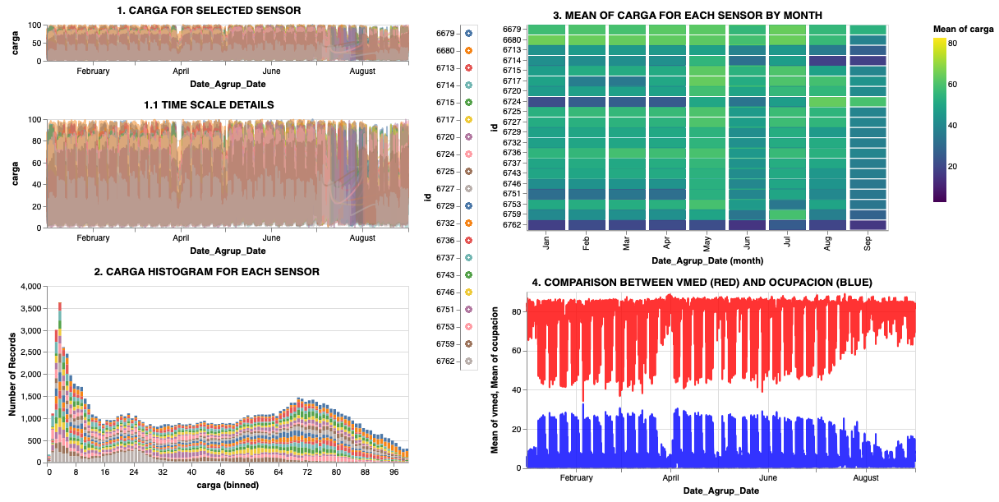

In [29]:
Dashboard